<a href="https://colab.research.google.com/github/quang08/DeepSort_YOLO/blob/main/YOLOv8_Detection_Tracking.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#**Thư viện cho việc hiện Video**

In [1]:
from IPython.display import Image

#**Clone Github Repo**


In [3]:
!git clone https://github.com/quang08/DeepSort_YOLO.git

fatal: destination path 'DeepSort_YOLO' already exists and is not an empty directory.


In [2]:
!pwd

/content


##Vào directory cần thiết

In [4]:
%cd /content/DeepSort_YOLO/

/content/DeepSort_YOLO


##Install tất cả dependencies

In [5]:
!pip install -e '.[dev]'

Obtaining file:///content/DeepSort_YOLO
  Preparing metadata (setup.py) ... done
  Attempting uninstall: ultralytics
    Found existing installation: ultralytics 8.0.3
    Uninstalling ultralytics-8.0.3:
      Successfully uninstalled ultralytics-8.0.3
  Running setup.py develop for ultralytics


##Vào mục detect để tiến hành train model

In [6]:
%cd /content/DeepSort_YOLO/ultralytics/yolo/v8/detect

/content/DeepSort_YOLO/ultralytics/yolo/v8/detect


##Lấy Dataset từ RoboFlow

In [7]:
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="XLjNc0SWzaXrXFw4Rzo9")
project = rf.workspace("drone-dataset-mvh8i").project("detection-bzujh")
dataset = project.version(1).download("yolov5")

  Using cached roboflow-1.1.7-py3-none-any.whl (58 kB)
  Using cached certifi-2022.12.7-py3-none-any.whl (155 kB)
  Using cached chardet-4.0.0-py2.py3-none-any.whl (178 kB)
  Using cached cycler-0.10.0-py2.py3-none-any.whl (6.5 kB)
  Using cached idna-2.10-py2.py3-none-any.whl (58 kB)
  Using cached opencv_python_headless-4.8.0.74-cp37-abi3-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (49.1 MB)
  Using cached pyparsing-2.4.7-py2.py3-none-any.whl (67 kB)
  Using cached python_dotenv-1.0.0-py3-none-any.whl (19 kB)
  Using cached supervision-0.14.0-py3-none-any.whl (63 kB)
  Using cached requests_toolbelt-1.0.0-py2.py3-none-any.whl (54 kB)
  Attempting uninstall: pyparsing
    Found existing installation: pyparsing 3.1.1
    Uninstalling pyparsing-3.1.1:
      Successfully uninstalled pyparsing-3.1.1
  Attempting uninstall: opencv-python-headless
    Found existing installation: opencv-python-headless 4.8.0.76
    Uninstalling opencv-python-headless-4.8.0.76:
      Successfully uninstal

loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to detection-1 in yolov5pytorch:: 100%|██████████| 9374/9374 [00:01<00:00, 8070.47it/s]


##Tải file Deep Sort

In [8]:
!gdown "https://drive.google.com/uc?id=11ZSZcG-bcbueXZC3rN08CM0qqX3eiHxf&confirm=t"


Downloading...
From: https://drive.google.com/uc?id=11ZSZcG-bcbueXZC3rN08CM0qqX3eiHxf&confirm=t
To: /content/DeepSort_YOLO/ultralytics/yolo/v8/detect/deep_sort_pytorch.zip
100% 43.1M/43.1M [00:00<00:00, 51.7MB/s]


##Unzip file DeepSORT

In [9]:
!unzip 'deep_sort_pytorch.zip'

Archive:  deep_sort_pytorch.zip
  inflating: deep_sort_pytorch/.gitignore  
   creating: deep_sort_pytorch/configs/
  inflating: deep_sort_pytorch/configs/deep_sort.yaml  
   creating: deep_sort_pytorch/deep_sort/
  inflating: deep_sort_pytorch/deep_sort/__init__.py  
   creating: deep_sort_pytorch/deep_sort/__pycache__/
  inflating: deep_sort_pytorch/deep_sort/__pycache__/__init__.cpython-310.pyc  
  inflating: deep_sort_pytorch/deep_sort/__pycache__/__init__.cpython-37.pyc  
  inflating: deep_sort_pytorch/deep_sort/__pycache__/__init__.cpython-38.pyc  
  inflating: deep_sort_pytorch/deep_sort/__pycache__/deep_sort.cpython-310.pyc  
  inflating: deep_sort_pytorch/deep_sort/__pycache__/deep_sort.cpython-37.pyc  
  inflating: deep_sort_pytorch/deep_sort/__pycache__/deep_sort.cpython-38.pyc  
   creating: deep_sort_pytorch/deep_sort/deep/
 extracting: deep_sort_pytorch/deep_sort/deep/__init__.py  
   creating: deep_sort_pytorch/deep_sort/deep/__pycache__/
  inflating: deep_sort_pytorch/d

#**Train Model**

In [10]:
HOME = '/content/DeepSort_YOLO/ultralytics/yolo/v8/detect'

In [11]:
%cd {HOME}

/content/DeepSort_YOLO/ultralytics/yolo/v8/detect


In [12]:
%cd {dataset.location}

/content/DeepSort_YOLO/ultralytics/yolo/v8/detect/detection-1


In [ ]:
%cd {HOME}

!python train.py model=yolov8l.pt data={dataset.location}/data.yaml epochs=50 imgsz=640

/content/YOLOv8-DeepSORT-Object-Tracking/ultralytics/yolo/v8/detect
100% 83.7M/83.7M [00:00<00:00, 247MB/s]

yolo/engine/trainer: task=detect, mode=train, model=yolov8l.pt, data=/content/YOLOv8-DeepSORT-Object-Tracking/ultralytics/yolo/v8/detect/detection-1/data.yaml, epochs=50, patience=50, batch=16, imgsz=640, save=True, cache=False, device=None, workers=8, project=None, name=None, exist_ok=False, pretrained=False, optimizer=SGD, verbose=False, seed=0, deterministic=True, single_cls=False, image_weights=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, show=False, save_txt=False, save_conf=False, save_crop=False, hide_labels=False, hide_conf=False, vid_stride=1, line_thickness=3, visualize=False, augment=False, agnostic_nms=False, retina_masks=False, format=torchscript, keras=False, optimize=False, i

#**Kiểm tra file trong mục /train**

In [14]:
!ls /content/DeepSort_YOLO/runs/detect/train

ls: cannot access '/content/DeepSort_YOLO/runs/detect/train': No such file or directory


#**In the Ma trận Confusion**

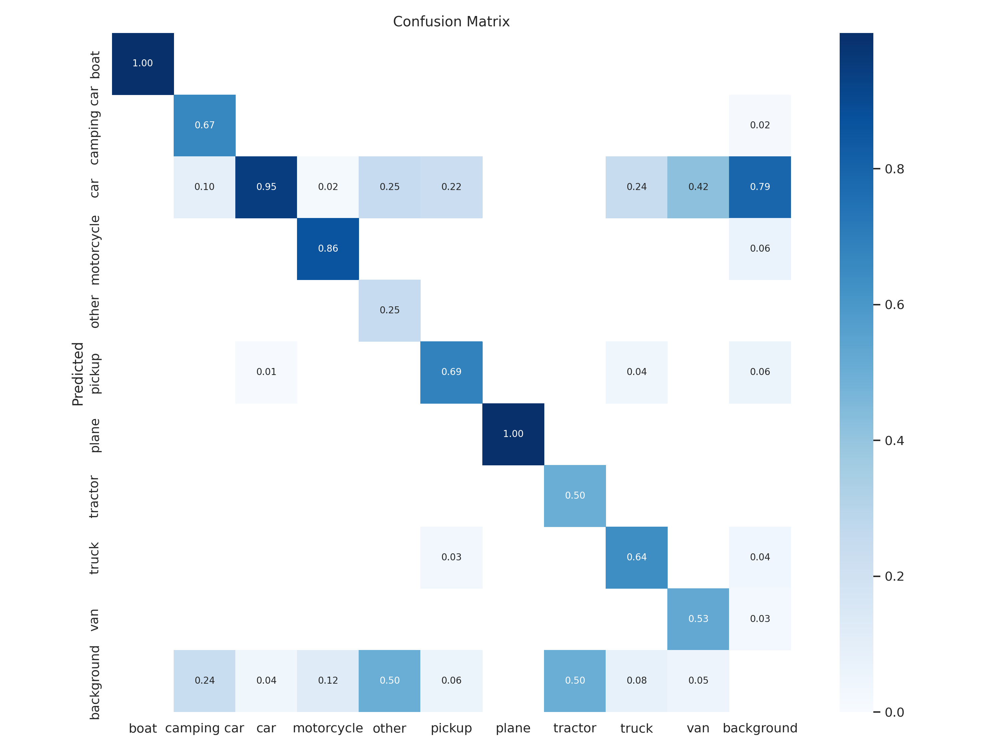

In [ ]:
Image(filename = '/content/DeepSort_YOLO/runs/detect/train2/confusion_matrix.png')

#**In Validation Loss**

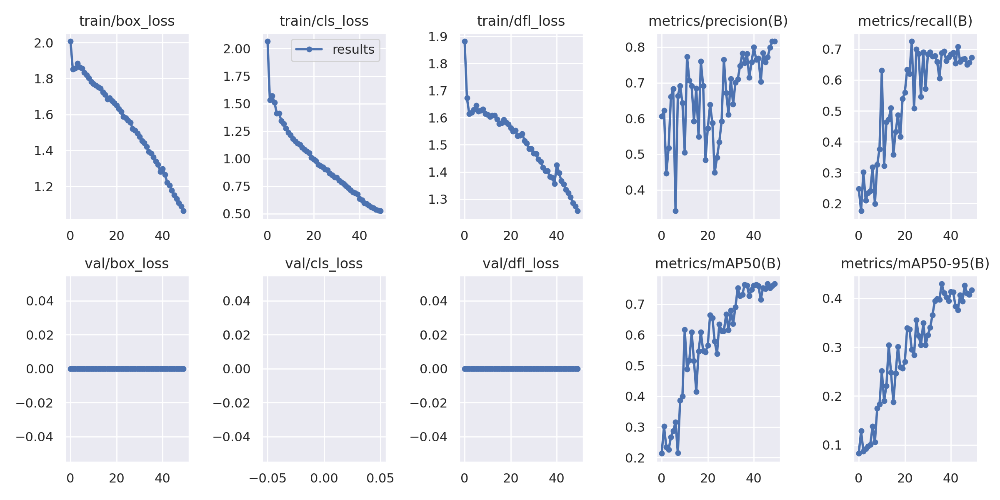

In [ ]:
Image(filename = r'/content/DeepSort_YOLO/runs/detect/train2/results.png', width = 600)

#**In the Dự đoán của Model trên Validation Batch**

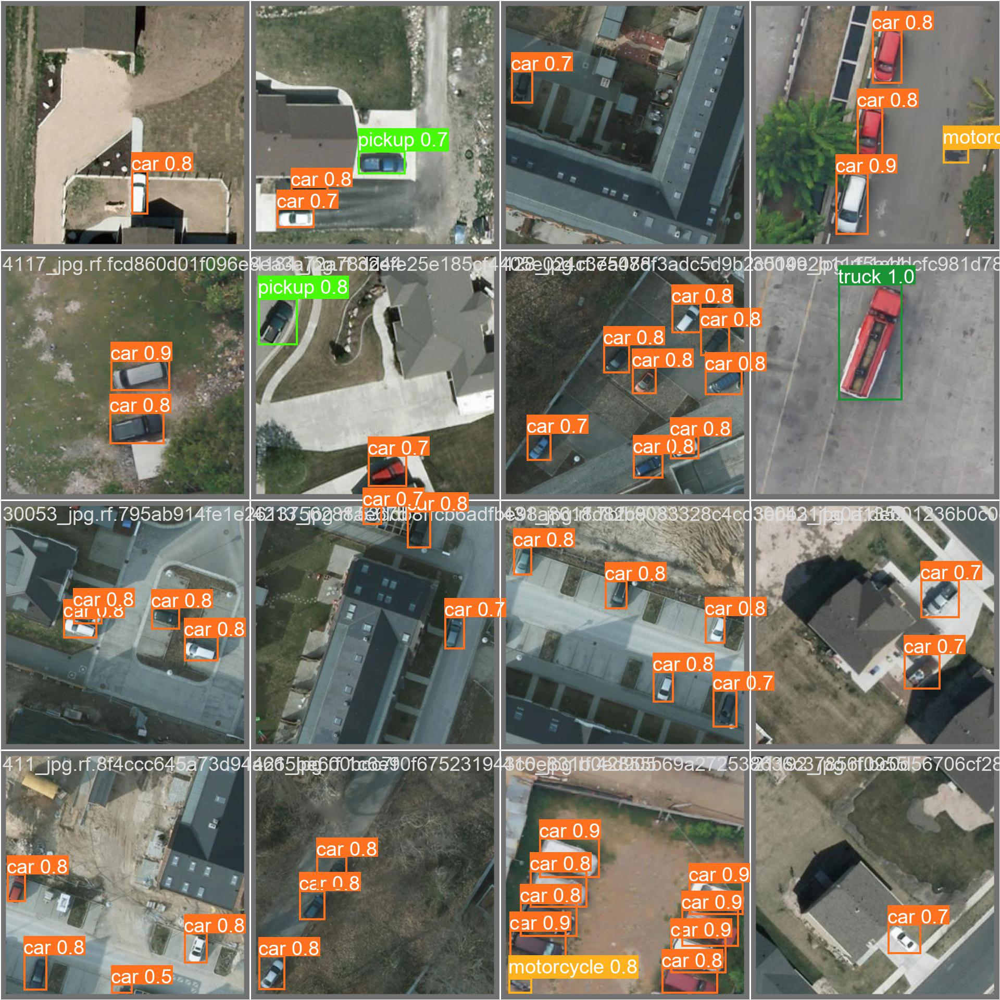

In [ ]:
Image(filename = r'/content/DeepSort_YOLO/runs/detect/train2/val_batch2_pred.jpg', width =600)

#**Tải model về Drive**


In [15]:
%cd {HOME}

/content/DeepSort_YOLO/ultralytics/yolo/v8/detect


In [16]:
!gdown "https://drive.google.com/uc?id=1VBAZtJ5uJMEsnyya_d0yMP6efBRQ8IX-&confirm=t"

Downloading...
From: https://drive.google.com/uc?id=1VBAZtJ5uJMEsnyya_d0yMP6efBRQ8IX-&confirm=t
To: /content/DeepSort_YOLO/ultralytics/yolo/v8/detect/best.pt
100% 87.7M/87.7M [00:02<00:00, 34.9MB/s]


#**Validate lại Model**

In [17]:
!pwd

/content/DeepSort_YOLO/ultralytics/yolo/v8/detect


In [ ]:
!python val.py model='best.pt' data={dataset.location}/data.yaml

2023-09-29 06:35:53.350459: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX512F FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-09-29 06:35:54.616426: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
Ultralytics YOLOv8.0.3 🚀 Python-3.10.12 torch-2.0.1+cu118 CUDA:0 (Tesla T4, 15102MiB)
Error executing job with overrides: ['model=best.pt', 'data=/content/YOLOv8-DeepSORT-Object-Tracking/ultralytics/yolo/v8/detect/detection-1/data.yaml']
Traceback (most recent call last):
  File "/content/YOLOv8-DeepSORT-Object-Tracking/ultralytics/yolo/v8/detect/val.py", line 237, in val
    validator(model=cfg.model)
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/_contextlib.py", line 115, in decorate_context
    return func(*args, **kwargs)
  File "/c

#**Inference with Custom Model**

#**Demo Video 1**

In [ ]:
!gdown "https://drive.google.com/uc?id=1UUZUS76ylH5RjMSc9s4rITSYDTG5AHt0&confirm=t"


Downloading...
From: https://drive.google.com/uc?id=1UUZUS76ylH5RjMSc9s4rITSYDTG5AHt0&confirm=t
To: /content/YOLOv8-DeepSORT-Object-Tracking/ultralytics/yolo/v8/detect/test4.mp4
100% 7.96M/7.96M [00:00<00:00, 12.5MB/s]


In [ ]:
!python predict2.py model='best.pt' source='test4.mp4'

[2023-09-29 06:50:11,182][root.tracker][INFO] - Loading weights from deep_sort_pytorch/deep_sort/deep/checkpoint/ckpt.t7... Done!
2023-09-29 06:50:11.527781: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX512F FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-09-29 06:50:12.482768: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
Ultralytics YOLOv8.0.3 🚀 Python-3.10.12 torch-2.0.1+cu118 CUDA:0 (Tesla T4, 15102MiB)
Fusing layers... 
Model summary: 268 layers, 43614318 parameters, 0 gradients, 164.9 GFLOPs
video 1/1 (1/808) /content/YOLOv8-DeepSORT-Object-Tracking/ultralytics/yolo/v8/detect/test4.mp4: 384x640 11 cars, 105.0ms
video 1/1 (2/808) /content/YOLOv8-DeepSORT-Object-Tracking/ultralytics/yolo/v8/detect/test4.mp4: 384x640 11 cars, 40.8ms
video

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


#**Display the Demo Video**

In [ ]:
!rm "/content/result_compressed.mp4"

In [ ]:
from IPython.display import HTML
from base64 import b64encode
import os

# Input video path
save_path = '/content/YOLOv8-DeepSORT-Object-Tracking/runs/detect/train5/test4.mp4'

# Compressed video path
compressed_path = "/content/result_compressed.mp4"

os.system(f"ffmpeg -i {save_path} -vcodec libx264 {compressed_path}")

# Show video
mp4 = open(compressed_path,'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=400 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

#**Demo Video 2**

In [ ]:
!gdown "https://drive.google.com/uc?id=1MaH6dNoegFjwkhtedxXufn2UD7EPpF_w&confirm=t"


Downloading...
From: https://drive.google.com/uc?id=1MaH6dNoegFjwkhtedxXufn2UD7EPpF_w&confirm=t
To: /content/YOLOv8-DeepSORT-Object-Tracking/ultralytics/yolo/v8/detect/test2.mp4
100% 3.79M/3.79M [00:00<00:00, 222MB/s]


In [ ]:
!python predict.py model='best.pt' source='test2.mp4'

[2023-01-22 17:27:43,594][root.tracker][INFO] - Loading weights from deep_sort_pytorch/deep_sort/deep/checkpoint/ckpt.t7... Done!
Ultralytics YOLOv8.0.3 🚀 Python-3.8.10 torch-1.13.1+cu116 CUDA:0 (Tesla T4, 15110MiB)
Fusing layers... 
Model summary: 268 layers, 43614318 parameters, 0 gradients, 164.9 GFLOPs
video 1/1 (1/319) /content/YOLOv8-DeepSORT-Object-Tracking/ultralytics/yolo/v8/detect/test2.mp4: 384x640 20 cars, 41.5ms
video 1/1 (2/319) /content/YOLOv8-DeepSORT-Object-Tracking/ultralytics/yolo/v8/detect/test2.mp4: 384x640 20 cars, 36.7ms
video 1/1 (3/319) /content/YOLOv8-DeepSORT-Object-Tracking/ultralytics/yolo/v8/detect/test2.mp4: 384x640 18 cars, 36.6ms
video 1/1 (4/319) /content/YOLOv8-DeepSORT-Object-Tracking/ultralytics/yolo/v8/detect/test2.mp4: 384x640 19 cars, 26.3ms
video 1/1 (5/319) /content/YOLOv8-DeepSORT-Object-Tracking/ultralytics/yolo/v8/detect/test2.mp4: 384x640 19 cars, 26.3ms
video 1/1 (6/319) /content/YOLOv8-DeepSORT-Object-Tracking/ultralytics/yolo/v8/detect/t

#**Display the Demo Video**

In [ ]:
!rm "/content/result_compressed.mp4"

In [ ]:
from IPython.display import HTML
from base64 import b64encode
import os

# Input video path
save_path = '/content/YOLOv8-DeepSORT-Object-Tracking/runs/detect/train2/test2.mp4'

# Compressed video path
compressed_path = "/content/result_compressed.mp4"

os.system(f"ffmpeg -i {save_path} -vcodec libx264 {compressed_path}")

# Show video
mp4 = open(compressed_path,'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=400 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)